In [ ]:
!kaggle datasets download -d soumikrakshit/anime-faces

Dataset URL: https://www.kaggle.com/datasets/soumikrakshit/anime-faces
License(s): unknown
100% 439M/441M [00:04<00:00, 95.5MB/s]
100% 441M/441M [00:04<00:00, 101MB/s] 


In [ ]:
!unzip /content/anime-faces.zip

Streaming output truncated to the last 5000 lines.
  inflating: data/data/5499.png      
  inflating: data/data/55.png        
  inflating: data/data/550.png       
  inflating: data/data/5500.png      
  inflating: data/data/5501.png      
  inflating: data/data/5502.png      
  inflating: data/data/5503.png      
  inflating: data/data/5504.png      
  inflating: data/data/5505.png      
  inflating: data/data/5506.png      
  inflating: data/data/5507.png      
  inflating: data/data/5508.png      
  inflating: data/data/5509.png      
  inflating: data/data/551.png       
  inflating: data/data/5510.png      
  inflating: data/data/5511.png      
  inflating: data/data/5512.png      
  inflating: data/data/5513.png      
  inflating: data/data/5514.png      
  inflating: data/data/5515.png      
  inflating: data/data/5516.png      
  inflating: data/data/5517.png      
  inflating: data/data/5518.png      
  inflating: data/data/5519.png      
  inflating: data/data/552.png       

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.layers import Input, Dense, Lambda, Flatten, Reshape, LeakyReLU
from keras.layers import Conv2D, Conv2DTranspose, MaxPool2D, AvgPool2D, UpSampling2D
from keras.layers import Activation, BatchNormalization, Add, Multiply
from keras.losses import mse, binary_crossentropy
from tensorflow.keras import backend as K
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

In [ ]:
data_path = '/content/data'
image_size = (64, 64)
batch_size = 32

latent_dim = 1024
num_epochs = 50

In [ ]:
def load_and_preprocess_data(data_path, image_size):
    datagen = ImageDataGenerator(rescale=1./255)
    data_generator = datagen.flow_from_directory(
        data_path,
        target_size=image_size,
        class_mode='input',
        shuffle=True
    )

    images, _ = next(data_generator)
    return images


images = load_and_preprocess_data(data_path, image_size)

Found 21551 images belonging to 1 classes.


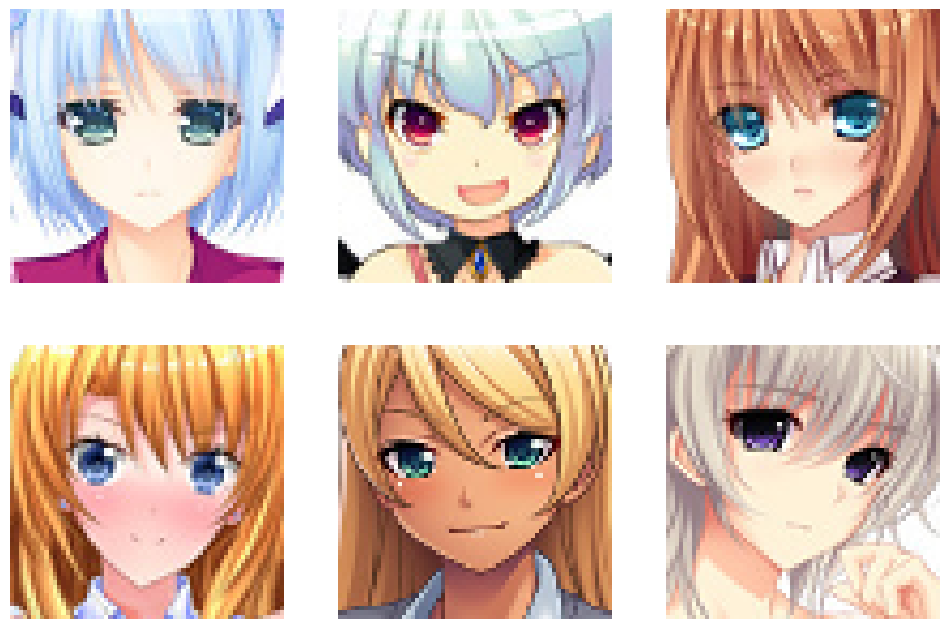

In [ ]:
def display_images(images):
    num_images = len(images)
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))
    for i in range(2):
        for j in range(3):
            if i*3 + j < num_images:
                axes[i, j].imshow(images[i*3 + j])
                axes[i, j].axis('off')

    plt.subplots_adjust(wspace=0.2, hspace=0.2)
    plt.show()

display_images(images[:6])

In [ ]:
def build_encoder(input_shape, latent_dim):
    inputs = Input(shape=input_shape)

    x = Conv2D(64, (1, 1), strides=(2, 2), padding='same')(inputs)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Conv2D(128, (4, 4), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Conv2D(256, (4, 4), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Conv2D(512, (4, 4), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Flatten()(x)
    x = Dense(2 * latent_dim)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    z_mean = Dense(latent_dim)(x)
    z_log_var = Dense(latent_dim)(x)

    def sampling(args):
        z_mean, z_log_var = args
        epsilon = K.random_normal(shape=(K.shape(z_mean)[0], latent_dim), mean=0.0, stddev=1.0)
        return z_mean + K.exp(0.5 * z_log_var) * epsilon

    z = Lambda(sampling)([z_mean, z_log_var])

    encoder_model = Model(inputs, [z_mean, z_log_var, z], name='encoder')
    return encoder_model

encoder = build_encoder((64, 64, 3), latent_dim)
encoder.summary()

Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 32, 32, 64)           256       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 32, 32, 64)           256       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)           0         ['batch_normalization[0]

In [ ]:
def build_decoder(latent_dim):
    decoder_input = Input(shape=(latent_dim,))
    x = Dense(4 * 4 * 512)(decoder_input)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Reshape((4, 4, 512))(x)

    x = Conv2DTranspose(256, (5, 5), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    x = Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    outputs = Conv2DTranspose(3, (5, 5), padding='same', activation='sigmoid')(x)

    decoder_model = Model(decoder_input, outputs, name='decoder')
    return decoder_model

decoder = build_decoder(latent_dim)
decoder.summary()

Model: "decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 1024)]            0         
                                                                 
 dense_3 (Dense)             (None, 8192)              8396800   
                                                                 
 batch_normalization_5 (Bat  (None, 8192)              32768     
 chNormalization)                                                
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 8192)              0         
                                                                 
 reshape (Reshape)           (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 8, 8, 256)         3277056   
 anspose)                                                  

In [ ]:
vae_input = Input(shape=(64, 64, 3))
vae_output = decoder(encoder(vae_input)[2])
vae = Model(vae_input, vae_output, name='vae')

vae.summary()

Model: "vae"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 encoder (Functional)        [(None, 1024),            23741312  
                              (None, 1024),                      
                              (None, 1024)]                      
                                                                 
 decoder (Functional)        (None, 64, 64, 3)         12840131  
                                                                 
Total params: 36581443 (139.55 MB)
Trainable params: 36558019 (139.46 MB)
Non-trainable params: 23424 (91.50 KB)
_________________________________________________________________


In [ ]:
def vae_loss(inputs, outputs):
    reconstruction_loss = tf.reduce_mean(tf.square(inputs - outputs))
    return reconstruction_loss

def ssim_metric(y_true, y_pred):
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

def psnr_metric(y_true, y_pred):
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

class CustomCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        n = 10
        random_images = images[np.random.choice(images.shape[0], n, replace=False)]
        reconstructed_images = vae.predict(random_images)

        plt.figure(figsize=(20, 4))
        for i in range(n):
            ax = plt.subplot(2, n, i + 1)
            plt.imshow(random_images[i])
            plt.axis('off')

            ax = plt.subplot(2, n, i + n + 1)
            plt.imshow(reconstructed_images[i])
            plt.axis('off')

        plt.show()

Epoch 1/50
1/1 [==============================] - 1s 1s/step


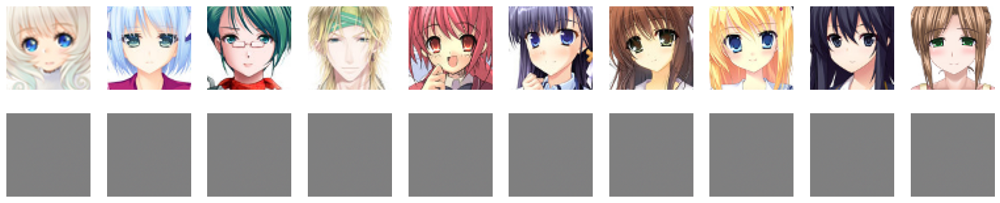

1/1 [==============================] - 19s 19s/step - loss: 0.1374 - ssim_metric: 0.0123 - psnr_metric: 8.6590
Epoch 2/50
1/1 [==============================] - 0s 310ms/step


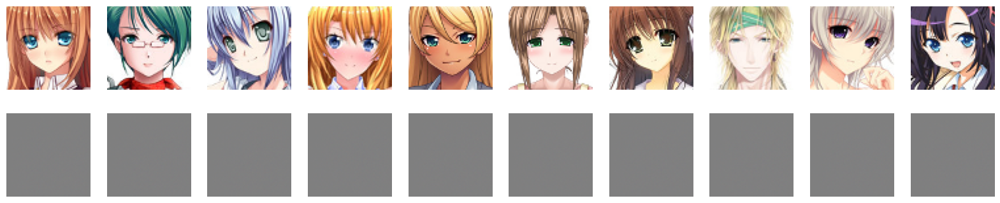

1/1 [==============================] - 7s 7s/step - loss: 0.1282 - ssim_metric: 0.0204 - psnr_metric: 8.9629
Epoch 3/50
1/1 [==============================] - 1s 1s/step


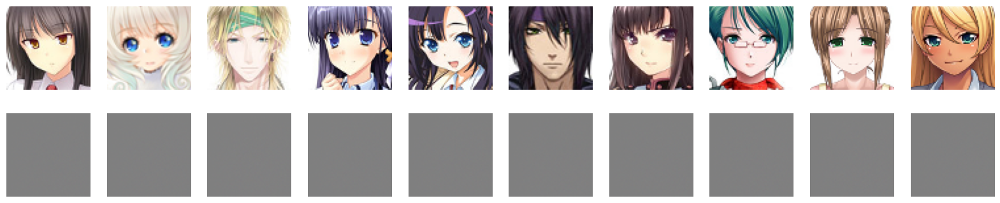

1/1 [==============================] - 16s 16s/step - loss: 0.1201 - ssim_metric: 0.0269 - psnr_metric: 9.2486
Epoch 4/50
1/1 [==============================] - 1s 564ms/step


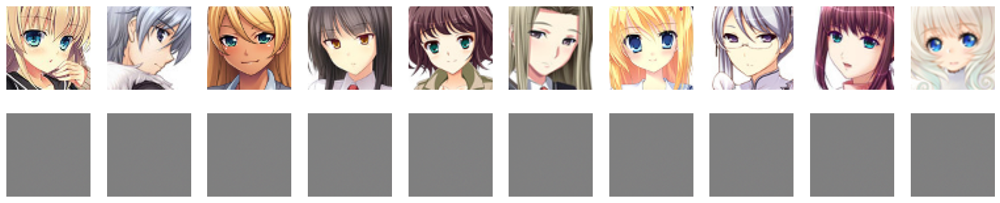

1/1 [==============================] - 12s 12s/step - loss: 0.1118 - ssim_metric: 0.0366 - psnr_metric: 9.5639
Epoch 5/50
1/1 [==============================] - 1s 564ms/step


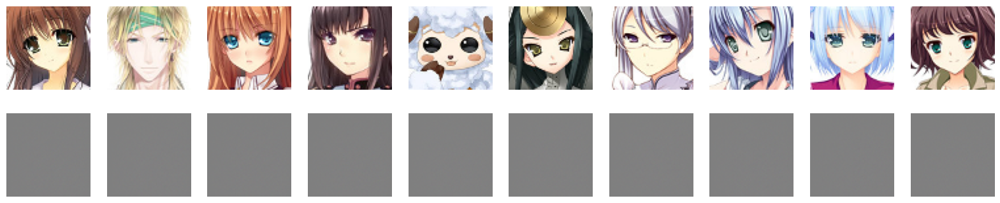

1/1 [==============================] - 11s 11s/step - loss: 0.1035 - ssim_metric: 0.0448 - psnr_metric: 9.8992
Epoch 6/50
1/1 [==============================] - 0s 439ms/step


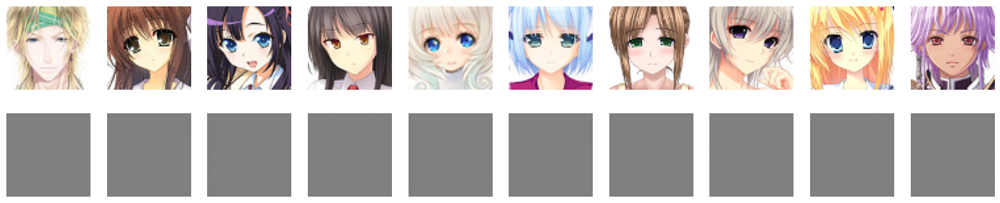

1/1 [==============================] - 8s 8s/step - loss: 0.0973 - ssim_metric: 0.0688 - psnr_metric: 10.1948
Epoch 7/50
1/1 [==============================] - 0s 472ms/step


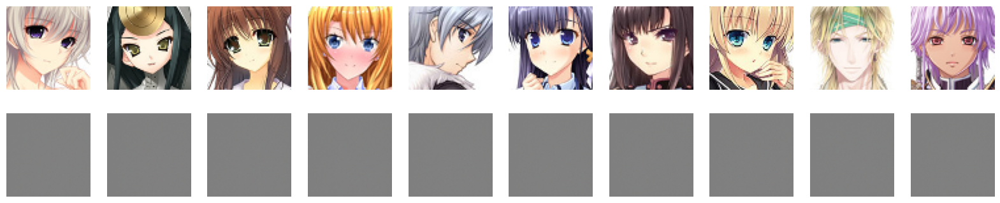

1/1 [==============================] - 7s 7s/step - loss: 0.0986 - ssim_metric: 0.0869 - psnr_metric: 10.1458
Epoch 8/50
1/1 [==============================] - 1s 506ms/step


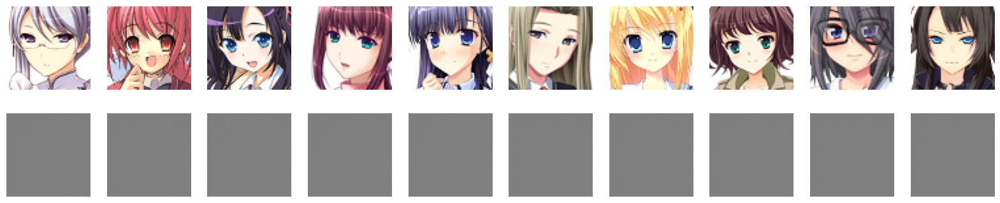

1/1 [==============================] - 11s 11s/step - loss: 0.0879 - ssim_metric: 0.0619 - psnr_metric: 10.6055
Epoch 9/50
1/1 [==============================] - 1s 508ms/step


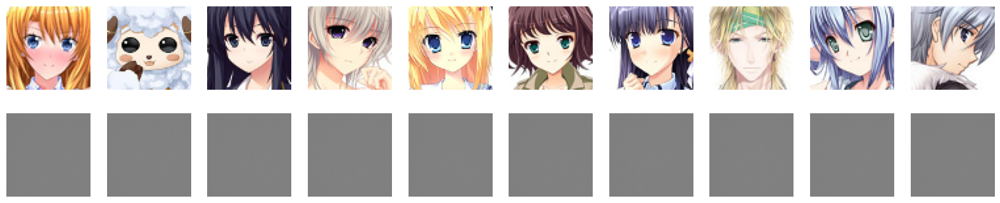

1/1 [==============================] - 8s 8s/step - loss: 0.0848 - ssim_metric: 0.0654 - psnr_metric: 10.7609
Epoch 10/50
1/1 [==============================] - 0s 498ms/step


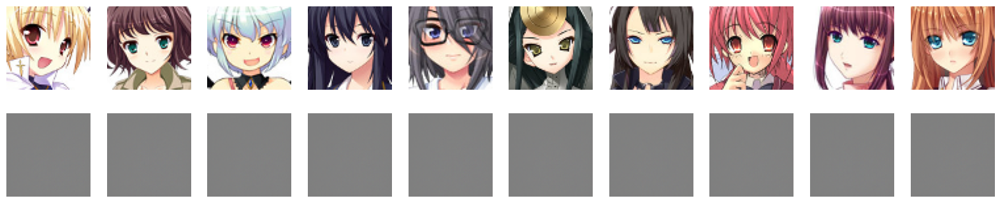

1/1 [==============================] - 9s 9s/step - loss: 0.0809 - ssim_metric: 0.0683 - psnr_metric: 10.9671
Epoch 11/50
1/1 [==============================] - 0s 400ms/step


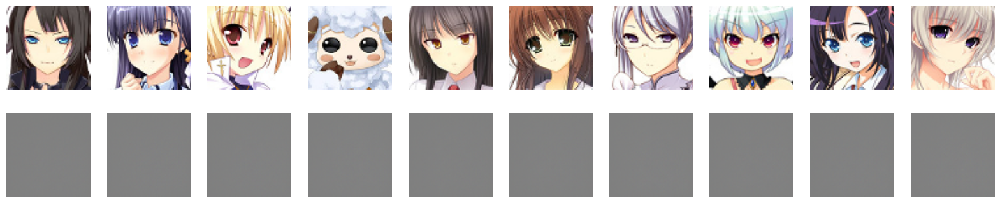

1/1 [==============================] - 7s 7s/step - loss: 0.0775 - ssim_metric: 0.0737 - psnr_metric: 11.1545
Epoch 12/50
1/1 [==============================] - 1s 507ms/step


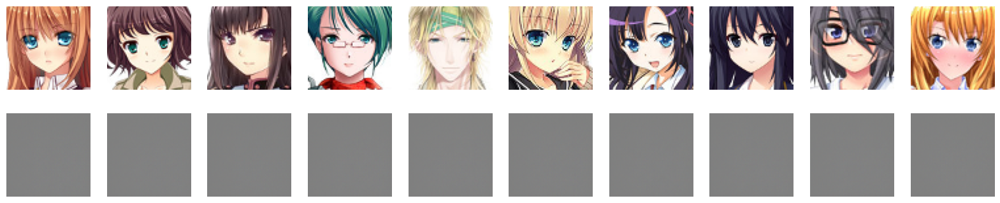

1/1 [==============================] - 7s 7s/step - loss: 0.0741 - ssim_metric: 0.0787 - psnr_metric: 11.3547
Epoch 13/50
1/1 [==============================] - 0s 326ms/step


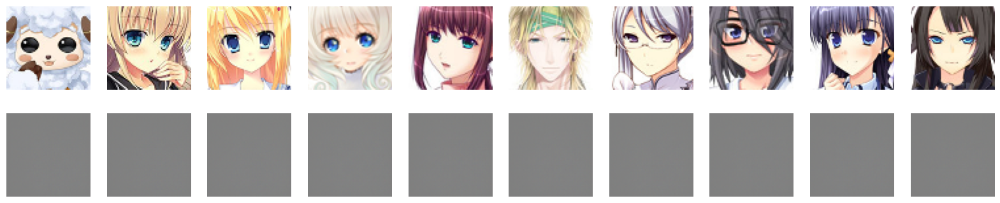

1/1 [==============================] - 8s 8s/step - loss: 0.0712 - ssim_metric: 0.0860 - psnr_metric: 11.5356
Epoch 14/50
1/1 [==============================] - 0s 319ms/step


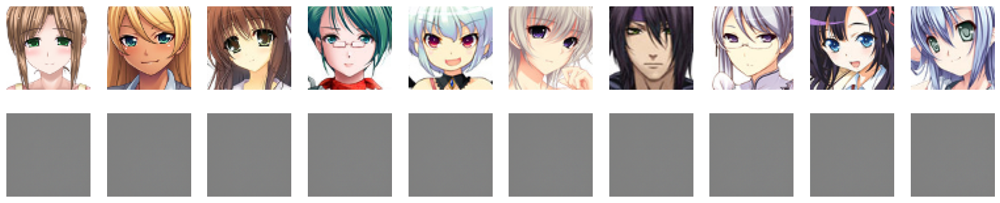

1/1 [==============================] - 6s 6s/step - loss: 0.0679 - ssim_metric: 0.0936 - psnr_metric: 11.7433
Epoch 15/50
1/1 [==============================] - 1s 547ms/step


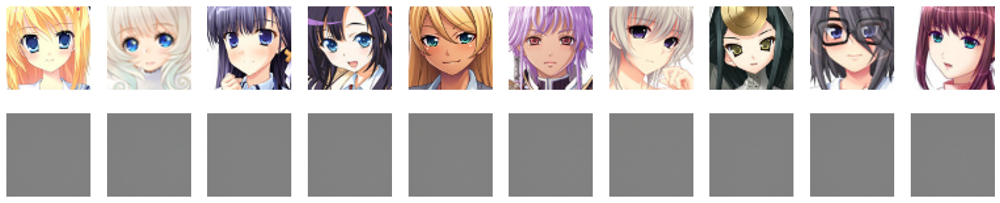

1/1 [==============================] - 7s 7s/step - loss: 0.0649 - ssim_metric: 0.0985 - psnr_metric: 11.9398
Epoch 16/50
1/1 [==============================] - 0s 327ms/step


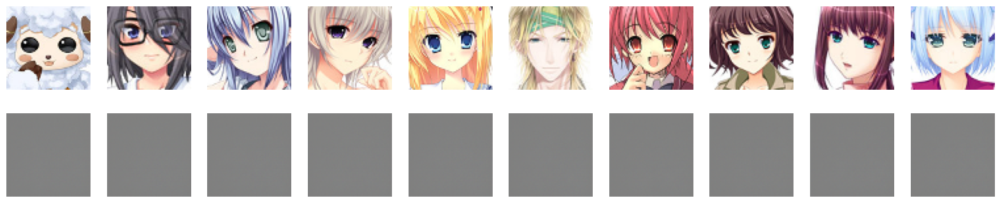

1/1 [==============================] - 8s 8s/step - loss: 0.0621 - ssim_metric: 0.1049 - psnr_metric: 12.1374
Epoch 17/50
1/1 [==============================] - 0s 325ms/step


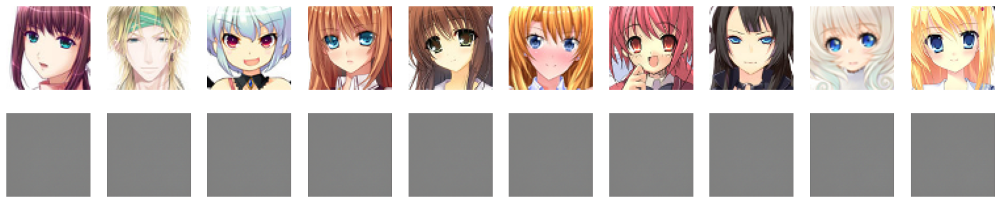

1/1 [==============================] - 7s 7s/step - loss: 0.0598 - ssim_metric: 0.1123 - psnr_metric: 12.2982
Epoch 18/50
1/1 [==============================] - 0s 482ms/step


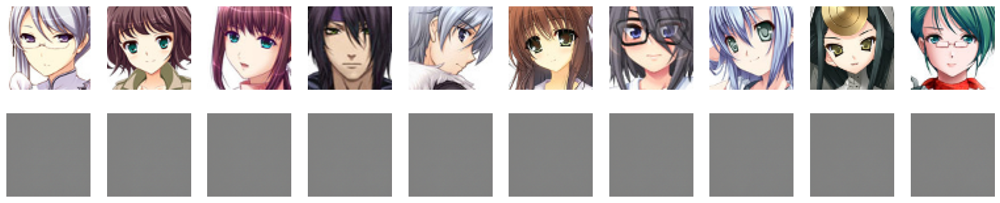

1/1 [==============================] - 8s 8s/step - loss: 0.0577 - ssim_metric: 0.1211 - psnr_metric: 12.4595
Epoch 19/50
1/1 [==============================] - 0s 366ms/step


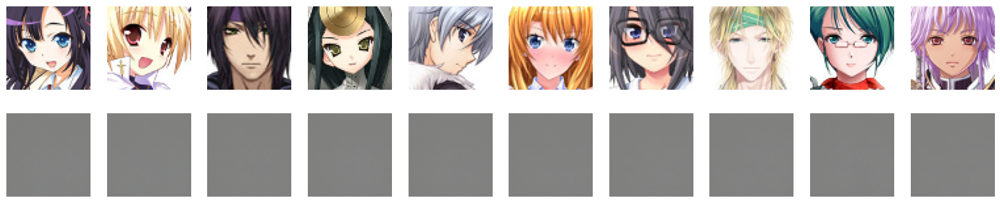

1/1 [==============================] - 8s 8s/step - loss: 0.0554 - ssim_metric: 0.1277 - psnr_metric: 12.6283
Epoch 20/50
1/1 [==============================] - 0s 338ms/step


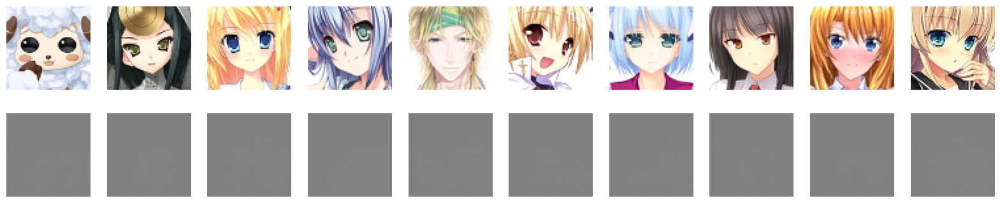

1/1 [==============================] - 6s 6s/step - loss: 0.0533 - ssim_metric: 0.1354 - psnr_metric: 12.8009
Epoch 21/50
1/1 [==============================] - 1s 514ms/step


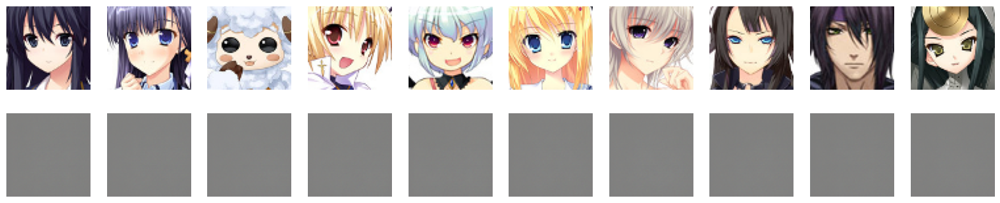

1/1 [==============================] - 10s 10s/step - loss: 0.0510 - ssim_metric: 0.1452 - psnr_metric: 12.9949
Epoch 22/50
1/1 [==============================] - 0s 352ms/step


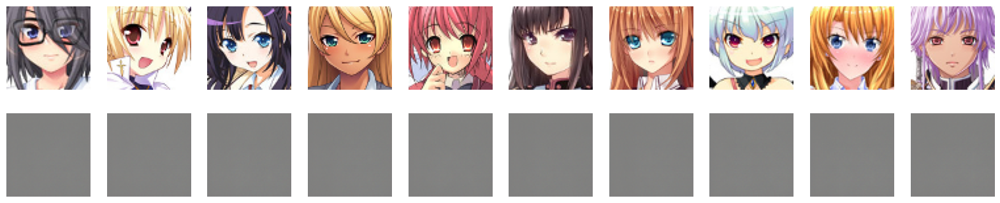

1/1 [==============================] - 7s 7s/step - loss: 0.0491 - ssim_metric: 0.1544 - psnr_metric: 13.1658
Epoch 23/50
1/1 [==============================] - 0s 421ms/step


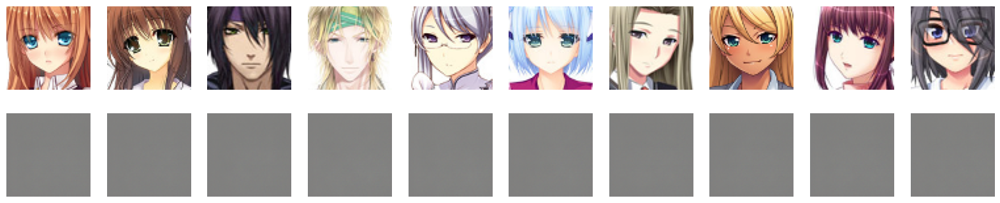

1/1 [==============================] - 6s 6s/step - loss: 0.0475 - ssim_metric: 0.1628 - psnr_metric: 13.3079
Epoch 24/50
1/1 [==============================] - 1s 571ms/step


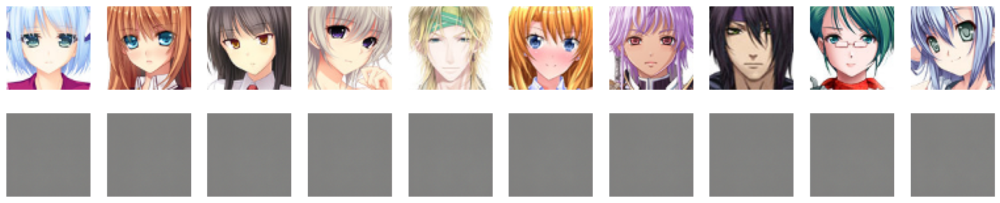

1/1 [==============================] - 8s 8s/step - loss: 0.0462 - ssim_metric: 0.1694 - psnr_metric: 13.4407
Epoch 25/50
1/1 [==============================] - 0s 376ms/step


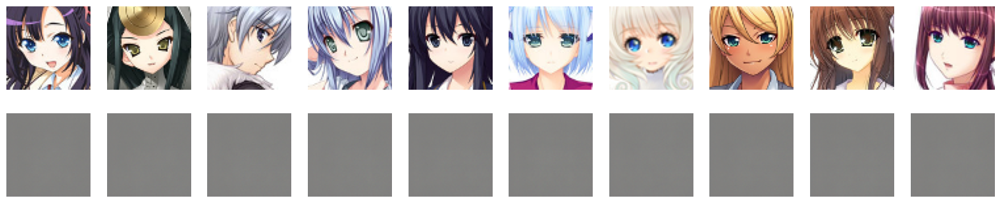

1/1 [==============================] - 9s 9s/step - loss: 0.0448 - ssim_metric: 0.1771 - psnr_metric: 13.5712
Epoch 26/50
1/1 [==============================] - 0s 380ms/step


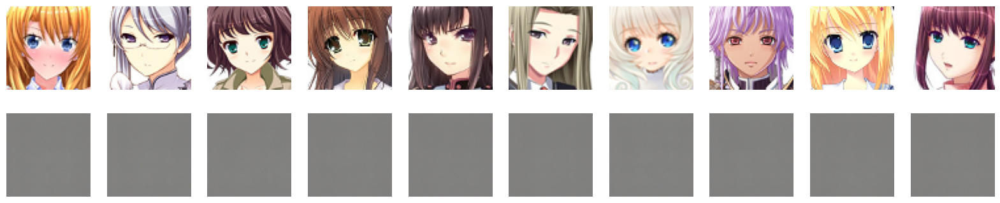

1/1 [==============================] - 6s 6s/step - loss: 0.0432 - ssim_metric: 0.1843 - psnr_metric: 13.7236
Epoch 27/50
1/1 [==============================] - 1s 538ms/step


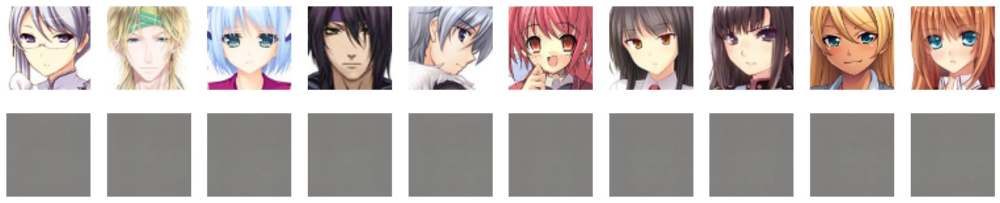

1/1 [==============================] - 9s 9s/step - loss: 0.0422 - ssim_metric: 0.1909 - psnr_metric: 13.8298
Epoch 28/50
1/1 [==============================] - 0s 380ms/step


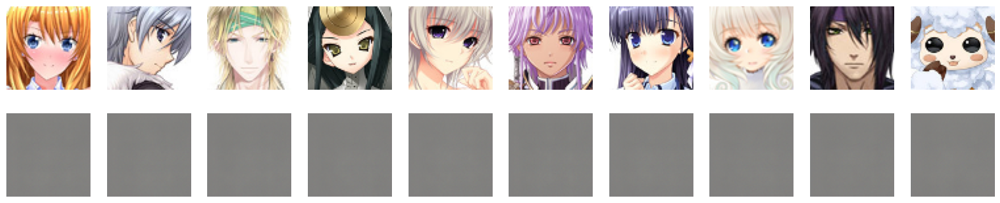

1/1 [==============================] - 8s 8s/step - loss: 0.0408 - ssim_metric: 0.2019 - psnr_metric: 13.9852
Epoch 29/50
1/1 [==============================] - 1s 764ms/step


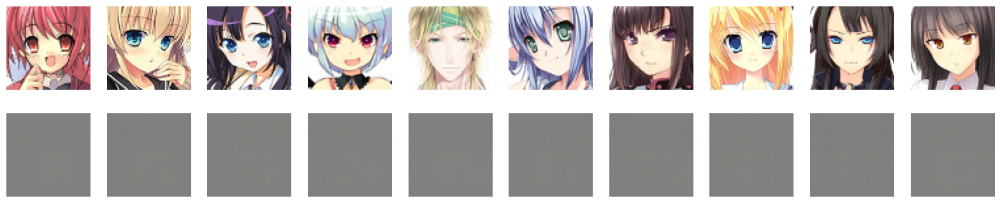

1/1 [==============================] - 13s 13s/step - loss: 0.0398 - ssim_metric: 0.2128 - psnr_metric: 14.0860
Epoch 30/50
1/1 [==============================] - 1s 576ms/step


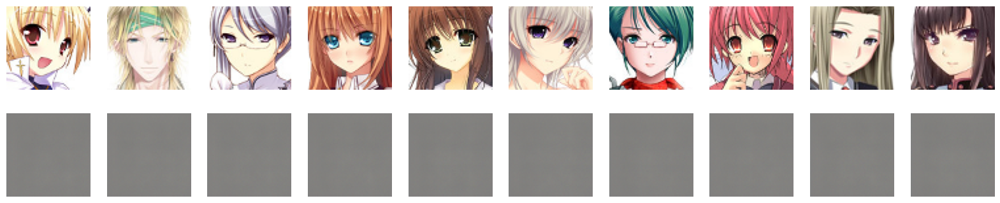

1/1 [==============================] - 9s 9s/step - loss: 0.0387 - ssim_metric: 0.2210 - psnr_metric: 14.2171
Epoch 31/50
1/1 [==============================] - 0s 379ms/step


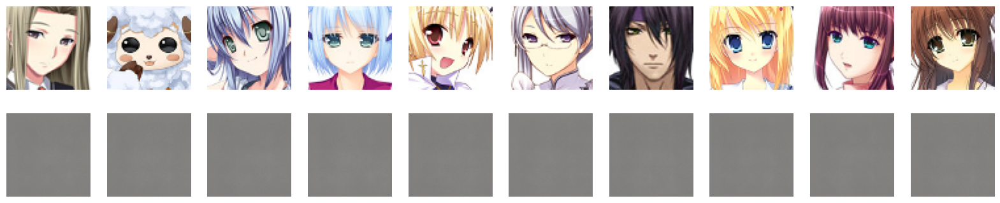

1/1 [==============================] - 6s 6s/step - loss: 0.0376 - ssim_metric: 0.2289 - psnr_metric: 14.3431
Epoch 32/50
1/1 [==============================] - 1s 564ms/step


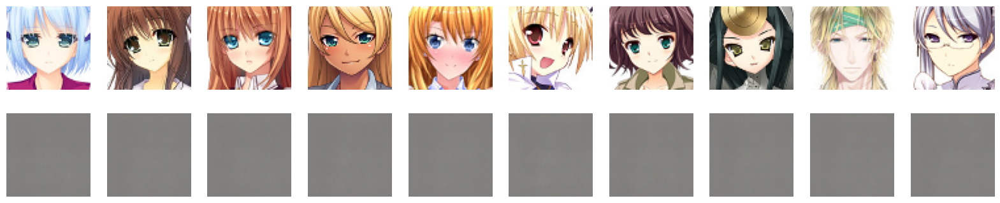

1/1 [==============================] - 8s 8s/step - loss: 0.0364 - ssim_metric: 0.2391 - psnr_metric: 14.4746
Epoch 33/50
1/1 [==============================] - 1s 649ms/step


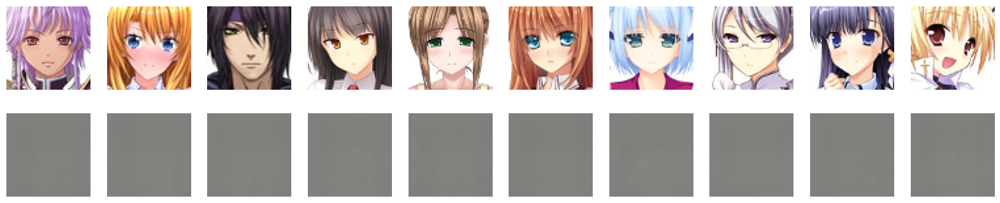

1/1 [==============================] - 9s 9s/step - loss: 0.0357 - ssim_metric: 0.2489 - psnr_metric: 14.5730
Epoch 34/50
1/1 [==============================] - 0s 423ms/step


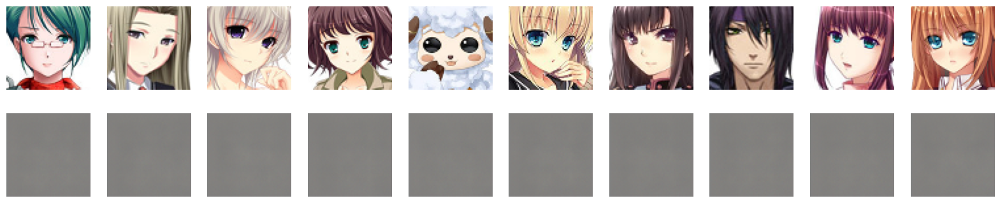

1/1 [==============================] - 6s 6s/step - loss: 0.0347 - ssim_metric: 0.2557 - psnr_metric: 14.6826
Epoch 35/50
1/1 [==============================] - 1s 582ms/step


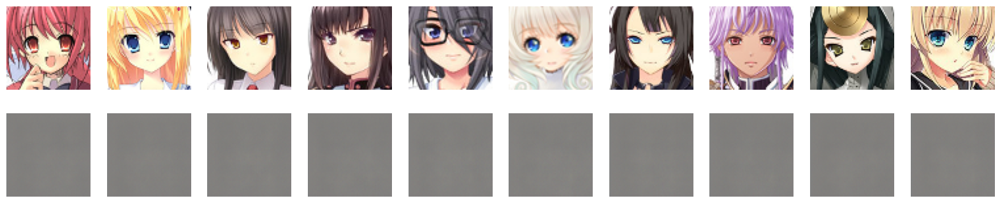

1/1 [==============================] - 8s 8s/step - loss: 0.0337 - ssim_metric: 0.2628 - psnr_metric: 14.8147
Epoch 36/50
1/1 [==============================] - 1s 609ms/step


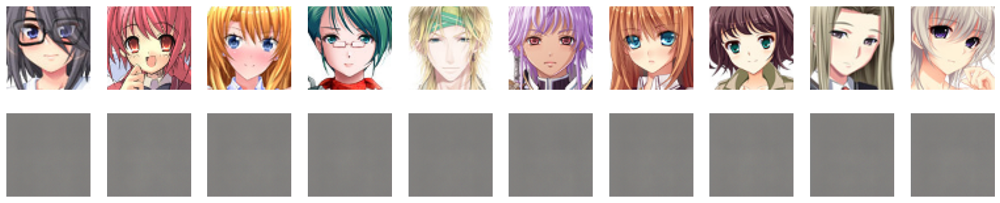

1/1 [==============================] - 9s 9s/step - loss: 0.0329 - ssim_metric: 0.2687 - psnr_metric: 14.9242
Epoch 37/50
1/1 [==============================] - 0s 402ms/step


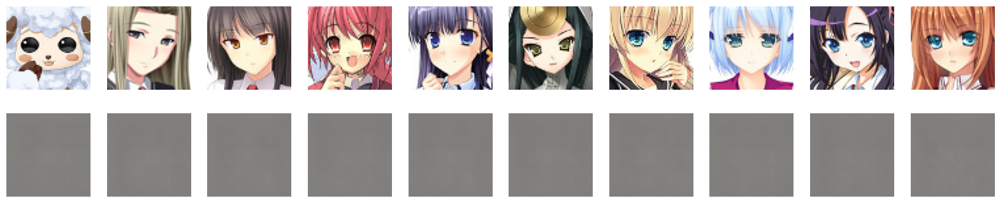

1/1 [==============================] - 6s 6s/step - loss: 0.0322 - ssim_metric: 0.2751 - psnr_metric: 15.0211
Epoch 38/50
1/1 [==============================] - 1s 579ms/step


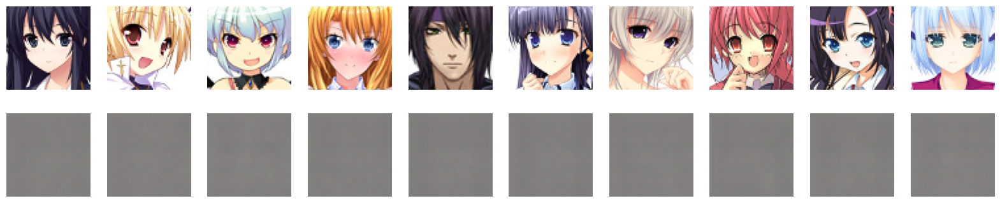

1/1 [==============================] - 7s 7s/step - loss: 0.0313 - ssim_metric: 0.2820 - psnr_metric: 15.1401
Epoch 39/50
1/1 [==============================] - 1s 649ms/step


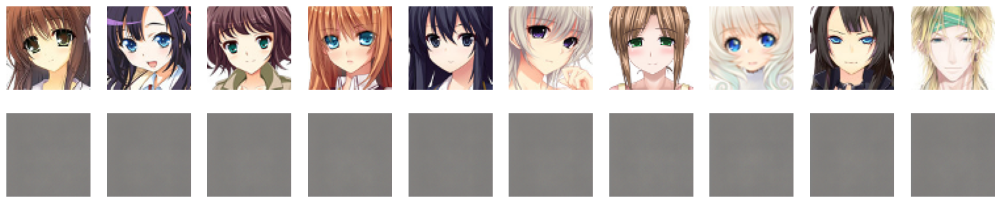

1/1 [==============================] - 11s 11s/step - loss: 0.0306 - ssim_metric: 0.2877 - psnr_metric: 15.2441
Epoch 40/50
1/1 [==============================] - 1s 538ms/step


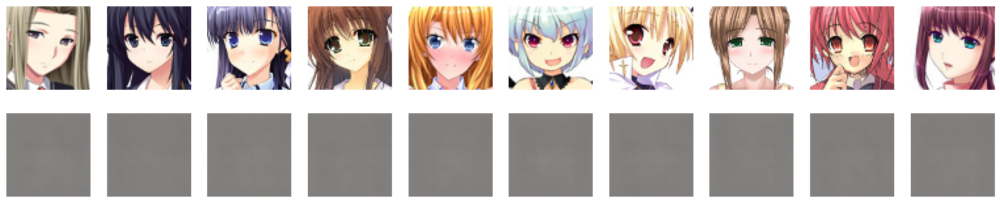

1/1 [==============================] - 10s 10s/step - loss: 0.0299 - ssim_metric: 0.2967 - psnr_metric: 15.3510
Epoch 41/50
1/1 [==============================] - 0s 438ms/step


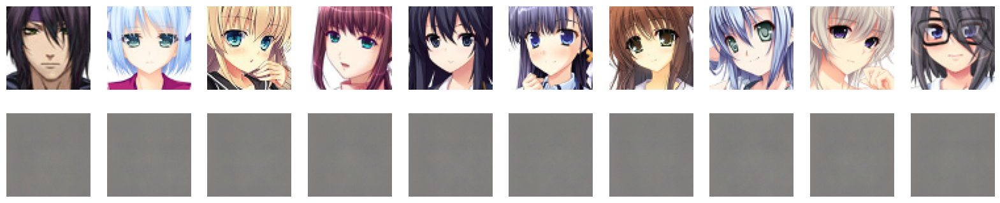

1/1 [==============================] - 7s 7s/step - loss: 0.0293 - ssim_metric: 0.3017 - psnr_metric: 15.4428
Epoch 42/50
1/1 [==============================] - 1s 532ms/step


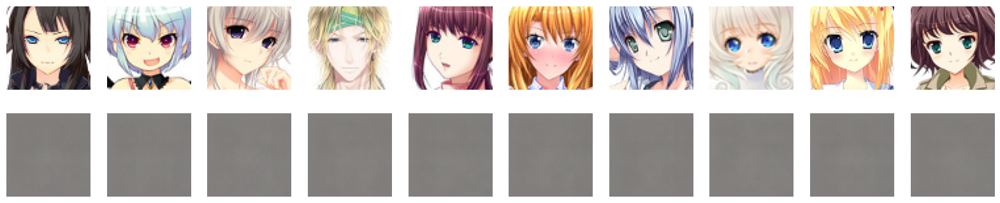

1/1 [==============================] - 9s 9s/step - loss: 0.0288 - ssim_metric: 0.3078 - psnr_metric: 15.5047
Epoch 43/50
1/1 [==============================] - 0s 350ms/step


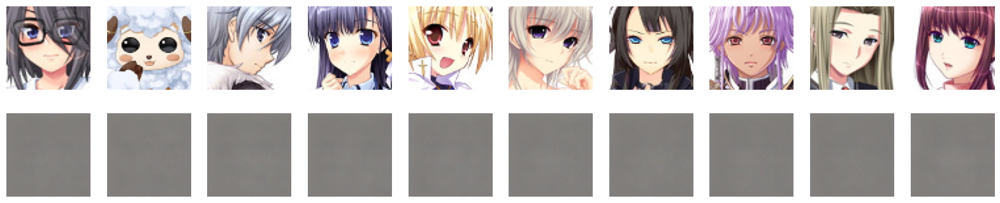

1/1 [==============================] - 9s 9s/step - loss: 0.0281 - ssim_metric: 0.3120 - psnr_metric: 15.6144
Epoch 44/50
1/1 [==============================] - 1s 596ms/step


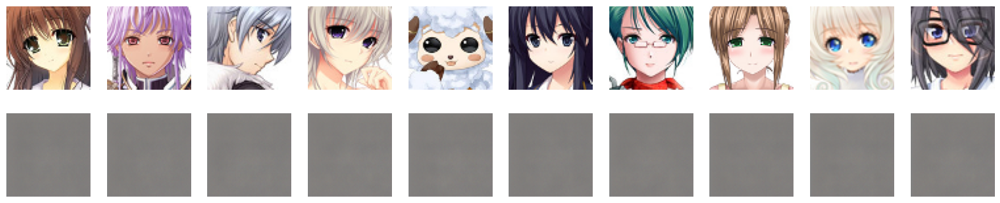

1/1 [==============================] - 9s 9s/step - loss: 0.0274 - ssim_metric: 0.3200 - psnr_metric: 15.7263
Epoch 45/50
1/1 [==============================] - 1s 612ms/step


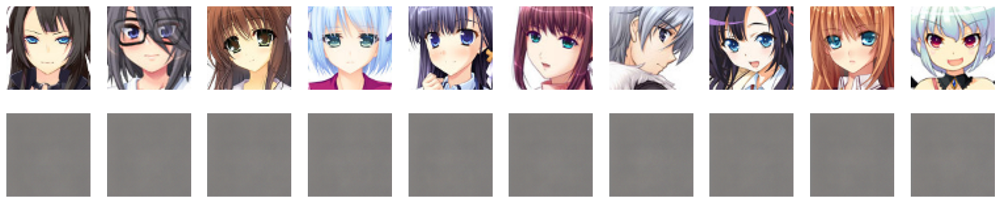

1/1 [==============================] - 9s 9s/step - loss: 0.0269 - ssim_metric: 0.3259 - psnr_metric: 15.8064
Epoch 46/50
1/1 [==============================] - 0s 459ms/step


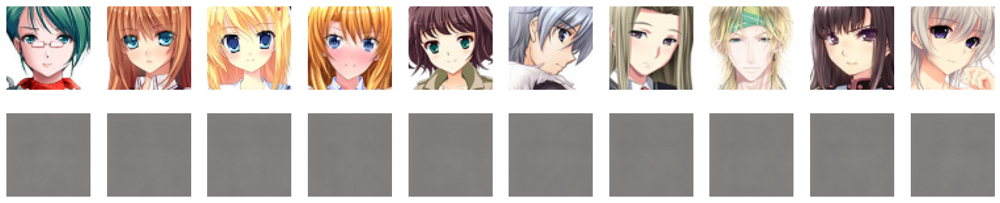

1/1 [==============================] - 9s 9s/step - loss: 0.0263 - ssim_metric: 0.3323 - psnr_metric: 15.8976
Epoch 47/50
1/1 [==============================] - 0s 454ms/step


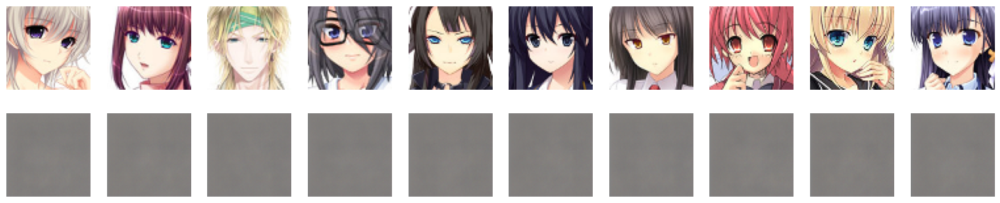

1/1 [==============================] - 6s 6s/step - loss: 0.0259 - ssim_metric: 0.3379 - psnr_metric: 15.9670
Epoch 48/50
1/1 [==============================] - 1s 574ms/step


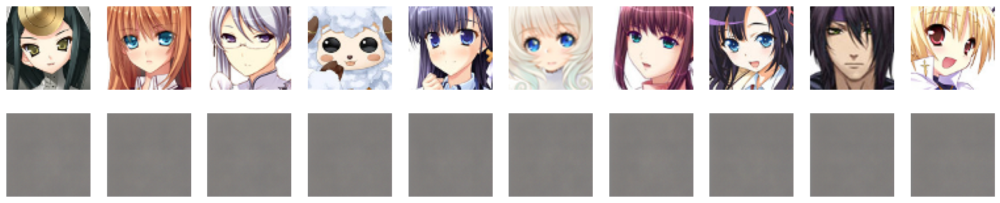

1/1 [==============================] - 9s 9s/step - loss: 0.0255 - ssim_metric: 0.3439 - psnr_metric: 16.0474
Epoch 49/50
1/1 [==============================] - 1s 651ms/step


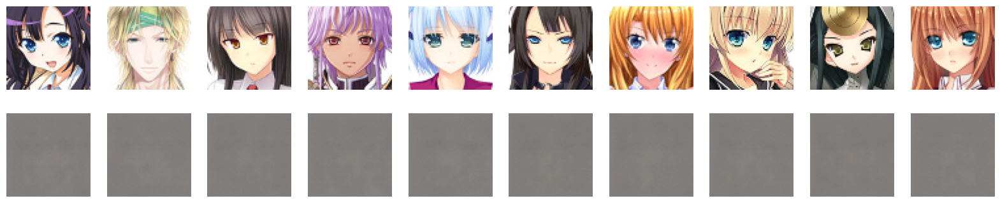

1/1 [==============================] - 9s 9s/step - loss: 0.0249 - ssim_metric: 0.3505 - psnr_metric: 16.1415
Epoch 50/50
1/1 [==============================] - 0s 474ms/step


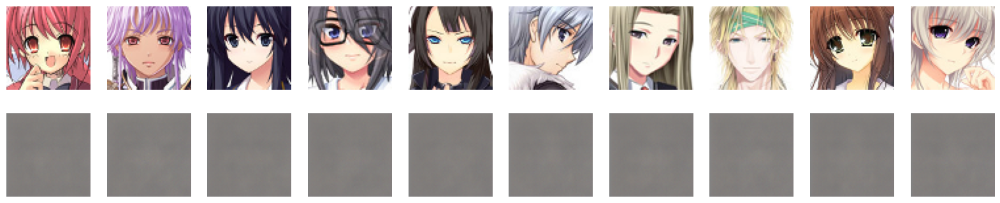

1/1 [==============================] - 7s 7s/step - loss: 0.0246 - ssim_metric: 0.3561 - psnr_metric: 16.2005


In [ ]:
learning_rate = 0.0001
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

vae.compile(optimizer=optimizer, loss=vae_loss, metrics=[ssim_metric, psnr_metric])

vae.fit(images, images, epochs=50, batch_size=batch_size, callbacks=[CustomCallback()])

1/1 [==============================] - 1s 744ms/step


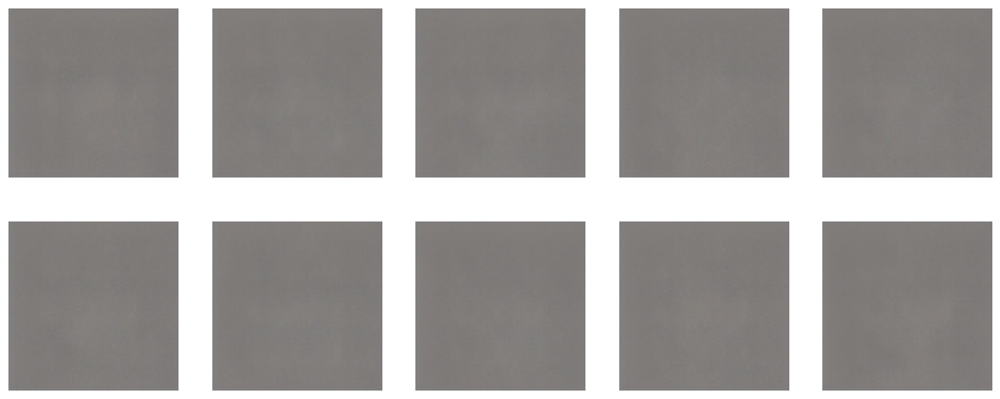

In [ ]:
def generate_anime_faces(num_faces=10):
    random_latent_vectors = np.random.normal(size=(num_faces, latent_dim))
    generated_images = decoder.predict(random_latent_vectors)

    plt.figure(figsize=(15, 6))
    for i in range(num_faces):
        ax = plt.subplot(2, num_faces // 2, i + 1)
        plt.imshow(generated_images[i])
        plt.axis('off')
    plt.show()

generate_anime_faces()

In [ ]:
vae.save('/content/vae_model.h5')
encoder.save('/content/encoder_model.h5')
decoder.save('/content/decoder_model.h5')

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import os

# Hyperparameters
latent_dim = 100
batch_size = 128
lr = 0.0002
num_epochs = 50
image_size = 28
channels = 1

# Create directory to save generated images
os.makedirs("images", exist_ok=True)

# Transformations
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

# Load the dataset
dataset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Generator model
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(latent_dim, 256),
            nn.ReLU(True),
            nn.Linear(256, 512),
            nn.ReLU(True),
            nn.Linear(512, 1024),
            nn.ReLU(True),
            nn.Linear(1024, image_size * image_size),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.main(z)
        img = img.view(img.size(0), channels, image_size, image_size)
        return img

# Discriminator model
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(image_size * image_size, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        img_flat = img.view(img.size(0), -1)
        validity = self.main(img_flat)
        return validity

# Check if CUDA is available and move models to GPU if possible
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

generator = Generator().to(device)
discriminator = Discriminator().to(device)

# Loss function and optimizers
adversarial_loss = nn.BCELoss().to(device)
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

# Training
for epoch in range(num_epochs):
    for i, (imgs, _) in enumerate(dataloader):

        # Move images to GPU if available
        imgs = imgs.to(device)

        # Adversarial ground truths
        valid = torch.ones(imgs.size(0), 1).to(device)
        fake = torch.zeros(imgs.size(0), 1).to(device)

        # Configure input
        real_imgs = imgs

        # -----------------
        #  Train Generator
        # -----------------
        optimizer_G.zero_grad()

        # Sample noise as generator input
        z = torch.randn(imgs.size(0), latent_dim).to(device)

        # Generate a batch of images
        gen_imgs = generator(z)

        # Loss measures generator's ability to fool the discriminator
        g_loss = adversarial_loss(discriminator(gen_imgs), valid)

        # Backward and optimize
        g_loss.backward()
        optimizer_G.step()

        # ---------------------
        #  Train Discriminator
        # ---------------------
        optimizer_D.zero_grad()

        # Measure discriminator's ability to classify real from generated samples
        real_loss = adversarial_loss(discriminator(real_imgs), valid)
        fake_loss = adversarial_loss(discriminator(gen_imgs.detach()), fake)
        d_loss = (real_loss + fake_loss) / 2

        # Backward and optimize
        d_loss.backward()
        optimizer_D.step()

        print(f"[Epoch {epoch}/{num_epochs}] [Batch {i}/{len(dataloader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")

    # Save generated images every epoch
    save_image(gen_imgs.data[:25], f"images/{epoch}.png", nrow=5, normalize=True)

# Plot some generated images
def show_generated_images():
    fig, ax = plt.subplots(5, 5, figsize=(5, 5))
    for i in range(5):
        for j in range(5):
            ax[i, j].imshow(gen_imgs[i*5 + j].cpu().detach().numpy().reshape(28, 28), cmap='gray')
            ax[i, j].axis('off')
    plt.show()

show_generated_images()
